In [164]:
!pip install pyspark
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [165]:
import matplotlib.pyplot as plt
import pyspark.sql.functions as F
import pyspark
import pandas as pd
import os.path
import glob, os
import geopandas
import folium
from pyspark.sql.window import Window
from pyspark.sql.types import *
from pyspark.sql.functions import lag
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.regression import LinearRegression
from pyspark.ml.pipeline import Pipeline
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.evaluation import RegressionEvaluator

from os import path

from folium.plugins import HeatMapWithTime
from folium.plugins import HeatMap


In [166]:
spark = pyspark.sql.SparkSession.builder.getOrCreate()

In [167]:
spark

# Data Collection

## Download the data

In [168]:
def download_from_github(url_list, new_folder):
  '''
  A function that downloads a given url and saves it to a folder 
  Input : 
  - url_list : list of urls
  - new_foler : name of folder where urls should be downloaded
  '''
  if path.exists('/content/' + new_folder) == False:
    os.mkdir('/content/' + new_folder)
  os.chdir('/content/' + new_folder)
  for url in url_list:
    !wget {url}

In [169]:
start_date = 2019
end_date = 2021
github_url = "https://github.com/rvm-courses/GasPrices/raw/master/"

price_url_list = []
for date in range(start_date, end_date+1):
  price_url_list.append(github_url + "Prix" + str(date) + ".csv.gz")

stations_url_list = []
stations_url_list.append(github_url + "Stations" + "2022" + ".csv.gz")

services_url_list = []
services_url_list.append(github_url + "Services" + "2022" + ".csv.gz")

In [170]:
# Download files from github
download_from_github(price_url_list, "Price")
download_from_github(stations_url_list, "Stations")
download_from_github(services_url_list, "Services")

# Download the departement geojson file for later use
os.chdir('/content/')
!wget https://github.com/gregoiredavid/france-geojson/raw/master/departements.geojson

--2023-01-06 21:15:19--  https://github.com/rvm-courses/GasPrices/raw/master/Prix2019.csv.gz
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rvm-courses/GasPrices/master/Prix2019.csv.gz [following]
--2023-01-06 21:15:19--  https://raw.githubusercontent.com/rvm-courses/GasPrices/master/Prix2019.csv.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 23902793 (23M) [application/octet-stream]
Saving to: ‘Prix2019.csv.gz.4’

Prix2019.csv.gz.4   100%[===================>]  22.79M   111MB/s    in 0.2s    

2023-01-06 21:15:20 (111 MB/s) - ‘Prix2019.csv.gz.4’ saved [23902793/23902793]

--2023-01-06 21

## Check the data has dowloaded

In [171]:
# Check if files have downloaded
os.chdir('/content/Price/')
for file in glob.glob("*.gz"):
  print(file)

os.chdir('/content/Services/')
for file in glob.glob("*.gz"):
  print(file)

os.chdir('/content/Stations/')
for file in glob.glob("*.gz"):
  print(file)

Prix2020.csv.gz
Prix2019.csv.gz
Prix2021.csv.gz
Services2022.csv.gz
Stations2022.csv.gz


# Data Preparation – step 1

## Read and merge all gas files

Because the files have few columns, we define the structure for each file.

In [172]:
schema = StructType(
    [StructField('id_pdv', IntegerType(), True), 
     StructField('cp', IntegerType(), True), 
     StructField('pop', StringType(), True), 
     StructField('latitude', DoubleType(), True), 
     StructField('longitude', DoubleType(), True), 
     StructField('date', TimestampType(), True), 
     StructField('id_carburant', IntegerType(), True), 
     StructField('nom_carburant', StringType(), True), 
     StructField('prix', IntegerType(), True)])

price_ddf = spark.read.csv('Price', sep=';', header=False, schema=schema).cache()

In [173]:
schema = StructType(
    [StructField('id_pdv', IntegerType(), True), 
     StructField('cp', IntegerType(), True), 
     StructField('pop', StringType(), True), 
     StructField('latitude', DoubleType(), True), 
     StructField('longitude', DoubleType(), True), 
     StructField('services', StringType(), True)])

services_ddf = spark.read.csv('Services', sep='|', header=False, schema=schema).cache()

In [174]:
schema = StructType(
    [StructField('id_pdv', IntegerType(), True), 
     StructField('cp', IntegerType(), True), 
     StructField('pop', StringType(), True), 
     StructField('latitude', DoubleType(), True), 
     StructField('longitude', DoubleType(), True), 
     StructField('adresse', StringType(), True), 
     StructField('ville', StringType(), True)])

stations_ddf = spark.read.csv('Stations', sep='|', header=False, schema=schema).cache()

Checking our dataframes

In [175]:
price_ddf.show(5)

+-------+----+---+---------+---------+-------------------+------------+-------------+----+
| id_pdv|  cp|pop| latitude|longitude|               date|id_carburant|nom_carburant|prix|
+-------+----+---+---------+---------+-------------------+------------+-------------+----+
|1000001|1000|  R|4620114.0| 519791.0|2021-01-02 15:13:25|           1|       Gazole|1252|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-04 09:28:43|           1|       Gazole|1268|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 09:29:19|           1|       Gazole|1268|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 15:45:51|           1|       Gazole|1268|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-07 09:44:40|           1|       Gazole|1273|
+-------+----+---+---------+---------+-------------------+------------+-------------+----+
only showing top 5 rows



In [176]:
services_ddf.show(5)

+-------+----+---+-------------+-------------+--------------------+
| id_pdv|  cp|pop|     latitude|    longitude|            services|
+-------+----+---+-------------+-------------+--------------------+
|1000001|1000|  R|    4620100.0|     519800.0|Station de gonfla...|
|1000002|1000|  R|    4621842.0|     522767.0|Vente de gaz dome...|
|1000004|1000|  R|    4618800.0|     524500.0|Toilettes publiqu...|
|1000005|1000|  R|4620093.59235|519942.024022|Boutique alimenta...|
|1000006|1000|  R|    4620754.0|     523758.0|Vente de gaz dome...|
+-------+----+---+-------------+-------------+--------------------+
only showing top 5 rows



In [177]:
stations_ddf.show(5)

+-------+----+---+-------------+-------------+--------------------+--------------------+
| id_pdv|  cp|pop|     latitude|    longitude|             adresse|               ville|
+-------+----+---+-------------+-------------+--------------------+--------------------+
|1000001|1000|  R|    4620100.0|     519800.0|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|
|1000002|1000|  R|    4621842.0|     522767.0| 16 Avenue de Marboz|     BOURG-EN-BRESSE|
|1000004|1000|  R|    4618800.0|     524500.0|20 Avenue du Maré...|     Bourg-en-Bresse|
|1000005|1000|  R|4620093.59235|519942.024022|642 Avenue de Tré...|SAINT-DENIS-LèS-B...|
|1000006|1000|  R|    4620754.0|     523758.0|1 Boulevard John ...|     BOURG-EN-BRESSE|
+-------+----+---+-------------+-------------+--------------------+--------------------+
only showing top 5 rows



Checking the number of rows in each dataframe

In [178]:
print(price_ddf.count())
print(services_ddf.count())
print(stations_ddf.count())

12365616
13637
13637


Merging our dataframes

In [179]:
price_ddf = price_ddf.join(services_ddf.select('id_pdv', 'services'), on=['id_pdv'], how='left')
price_ddf = price_ddf.join(stations_ddf.select('id_pdv', 'adresse', 'ville'), on=['id_pdv'], how='left').cache()

In [180]:
price_ddf.show(5)

+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+
| id_pdv|  cp|pop| latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|
+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+
|1000001|1000|  R|4620114.0| 519791.0|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 15:45:51|           1|     

In [181]:
# Make sure we have the same number of rows as before
price_ddf.count()

12365616

### Check for null values and outliers

In [182]:
# The columns we want to check for null values.
df_Columns=["id_pdv","cp","latitude", 'longitude', 'id_carburant', 'nom_carburant', 'prix', 'services', 'adresse', 'ville']
# Date formats do not work with the functions that we are going to use to check na and null

# Check for NA
price_ddf.select([F.count(F.when(F.isnan(c), c)).alias(c) for c in df_Columns]).show()

+------+---+--------+---------+------------+-------------+----+--------+-------+-----+
|id_pdv| cp|latitude|longitude|id_carburant|nom_carburant|prix|services|adresse|ville|
+------+---+--------+---------+------------+-------------+----+--------+-------+-----+
|     0|  0|       0|        0|           0|            0|   0|       0|      0|    0|
+------+---+--------+---------+------------+-------------+----+--------+-------+-----+



In [183]:
# Check for null
price_ddf.select([F.count(F.when(F.col(c).isNull(), c)).alias(c) for c in df_Columns]).show()

+------+---+--------+---------+------------+-------------+-----+--------+-------+-----+
|id_pdv| cp|latitude|longitude|id_carburant|nom_carburant| prix|services|adresse|ville|
+------+---+--------+---------+------------+-------------+-----+--------+-------+-----+
|     0|  0|     203|      200|       10560|        10560|10560| 2110221|  53218|53218|
+------+---+--------+---------+------------+-------------+-----+--------+-------+-----+



In [184]:
# For the columns 'services', 'adresse' and 'ville', these contain null values because we are using files from different years, some of the gas stations may have closed
# Look at the data when latitude is null
price_ddf.filter(F.col("latitude").isNull()).show(10)

+--------+-----+---+--------+---------+----+------------+-------------+----+--------------------+--------------------+--------------------+
|  id_pdv|   cp|pop|latitude|longitude|date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|
+--------+-----+---+--------+---------+----+------------+-------------+----+--------------------+--------------------+--------------------+
| 1200004| 1200|  R|    null|     null|null|        null|         null|null|                null|79 RUE DE LA REPU...|          BELLEGARDE|
| 2100014| 2100|  R|    null|     null|null|        null|         null|null|Toilettes publiqu...|60 BIS RUE DE LA ...|       SAINT QUENTIN|
| 4210001| 4210|  R|    null|     null|null|        null|         null|null|Boutique alimenta...|       6 rd MANOSQUE|           VALENSOLE|
| 6000012| 6000|  R|    null|     null|null|        null|         null|null|Toilettes publiqu...| 26,28 QUAI GALLIENI|                NICE|
|10000017|10000|  R|

In [185]:
# Look at the data when id_carburant is null and latitude is notnull
price_ddf.filter(price_ddf.latitude.isNotNull() & price_ddf.id_carburant.isNull()).show()

+-------+----+---+---------------+---------------+----+------------+-------------+----+--------------------+--------------------+--------------------+
| id_pdv|  cp|pop|       latitude|      longitude|date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|
+-------+----+---+---------------+---------------+----+------------+-------------+----+--------------------+--------------------+--------------------+
|1000005|1000|  R|  4620093.59235|  519942.024022|null|        null|         null|null|Boutique alimenta...|642 Avenue de Tré...|SAINT-DENIS-LèS-B...|
|1000006|1000|  R|      4620754.0|       523758.0|null|        null|         null|null|Vente de gaz dome...|1 Boulevard John ...|     BOURG-EN-BRESSE|
|1000010|1000|  R|  4619851.83794|  524350.637881|null|        null|         null|null|DAB (Distributeur...|Boulevard Charles...|     BOURG-EN-BRESSE|
|1100003|1100|  R|      4624966.0|       564134.0|null|        null|         null|null|Boutiqu

In [186]:
# Drop the rows with null values in 
price_ddf = price_ddf.na.drop(subset=['latitude', 'id_carburant']).cache()
# This will leave us with nulls in 'services', 'adresse' and 'ville'

In [187]:
# Check for outliers or wrong data
price_ddf.select('id_pdv', 'cp', 'latitude', 'longitude', 'id_carburant', 'prix').describe().show()

+-------+--------------------+------------------+------------------+------------------+------------------+------------------+
|summary|              id_pdv|                cp|          latitude|         longitude|      id_carburant|              prix|
+-------+--------------------+------------------+------------------+------------------+------------------+------------------+
|  count|            12355056|          12355056|          12355056|          12355056|          12355056|          12355056|
|   mean|  5.24084686062552E7| 52383.98943906042| 4693287.191886473| 267556.6898844614|3.6502758870538505|1403.0028607721406|
| stddev|2.7141207491000663E7|27141.704555362645|225806.25731602177|267662.16469460423| 2.069486593477485|253.38840345670874|
|    min|             1000001|              1000|         4139100.0|         -472300.0|                 1|                 1|
|    max|            95870009|             95870|         5106500.0|          954719.0|                 6|            

In [188]:
# The prices start at 0,001€ this has to be an error in the data.
price_ddf.orderBy('prix', ascending=True).show(20, truncate=False)
# The first locations seem to be real stations, so the price seems to be an error

+--------+-----+---+---------------+----------------+-------------------+------------+-------------+----+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+----------------------------+---------------------+
|id_pdv  |cp   |pop|latitude       |longitude       |date               |id_carburant|nom_carburant|prix|services                                                                                                                                                                                                                                                                                                                                                             |adresse               

In [189]:
# The prices goo up to 9€, we will check this
price_ddf.orderBy('prix', ascending=False).show(20, truncate=False)
# This first 2 locations are a AVIA gas station near Rouen

+--------+-----+---+---------------+--------------+-------------------+------------+-------------+----+--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+--------------------------+-----------------------+
|id_pdv  |cp   |pop|latitude       |longitude     |date               |id_carburant|nom_carburant|prix|services                                                                                                                                                                                                                                                                                                                                    |adresse                   |ville                  |
+--------+-----+---+----

There seems to be quite a few errors in the column price of our data. Prices start at less than 0,01€ and concern mainly GPL and ethanol. Prices also seem to go very high at over 7€ for multiple rows. If we were to do an in depth forecast, we would want to correct theses errors.

## Split date in year, month, week of the year

In [190]:
# Using substring 
(price_ddf
 .withColumn('year', F.substring('date', 1,4))
 .withColumn('month', F.substring('date', 6,2))
 .withColumn('day', F.substring('date', 9,2))
 ).show(5)

+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
| id_pdv|  cp|pop| latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|
+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
|1000001|1000|  R|4620114.0| 519791.0|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|   01| 02|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|   01| 04|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|20

In [191]:
# Using spark functions
(price_ddf
 .withColumn('year', F.year("date"))
 .withColumn('month', F.month("date"))
 .withColumn('day', F.dayofmonth("date"))
).show(5)

+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
| id_pdv|  cp|pop| latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|
+-------+----+---+---------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
|1000001|1000|  R|4620114.0| 519791.0|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  2|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  4|
|1000001|1000|  R|4620114.0| 519791.0|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|20

In [194]:
price_ddf = (price_ddf
 .withColumn('year', F.year("date"))
 .withColumn('month', F.month("date"))
 .withColumn('day', F.dayofmonth("date"))
)

## Prepare latitude & longitude for mapping (divide by the right power of 10)

In [195]:
price_ddf = (price_ddf
  .withColumn('latitude', F.col('latitude') / 10**5)
  .withColumn('longitude', F.col('longitude') / 10**5)
  ).cache()
  
price_ddf.show(5)

+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
| id_pdv|  cp|pop|latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|
+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
|1000001|1000|  R|46.20114|  5.19791|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  2|
|1000001|1000|  R|46.20114|  5.19791|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  4|
|1000001|1000|  R|46.20114|  5.19791|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|   

## Make data available as a table in order to be able to use Spark SQL

In [196]:
price_ddf.createOrReplaceTempView('price_SQL')

spark.sql("""
SELECT *
FROM price_SQL
""").show(5)

+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
| id_pdv|  cp|pop|latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|
+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+
|1000001|1000|  R|46.20114|  5.19791|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  2|
|1000001|1000|  R|46.20114|  5.19791|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  4|
|1000001|1000|  R|46.20114|  5.19791|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|   

# Data Preparation – step 2

## Compute a new variable called “Price Index” for each gas type sold in a station

### Compute an intermediate column of the mean price per day

Using SQL

In [197]:
# We create an intermediate table for the average price per day per fuel type
spark.sql("""
SELECT nom_carburant, year, month, day, avg(prix) as mean_price_day
FROM price_SQL
GROUP BY nom_carburant, year, month, day
""").createOrReplaceTempView('mean_price_SQL')

# We join both tables and compute price_index
spark.sql("""
SELECT price_SQL.* , mean_price_SQL.mean_price_day, 100 * (prix - mean_price_day) / mean_price_day + 1 as price_index
FROM mean_price_SQL
LEFT JOIN price_SQL ON price_SQL.nom_carburant = mean_price_SQL.nom_carburant
AND price_SQL.year = mean_price_SQL.year
AND price_SQL.month = mean_price_SQL.month
AND price_SQL.day = mean_price_SQL.day;
""").show(5)

+-------+----+---+-------------+-----------------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+------------------+-------------------+
| id_pdv|  cp|pop|     latitude|        longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|    mean_price_day|        price_index|
+-------+----+---+-------------+-----------------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+------------------+-------------------+
|1000009|1000|  R|     46.19566|          5.22935|2021-01-23 08:56:49|           5|          E10|1385|Laverie,Boutique ...|     56 Rue du Stand|     Bourg-en-Bresse|2021|    1| 23|1433.7497824194952|-2.4001597082880464|
|1000012|1000|  R|       46.201|              5.2|2021-01-23 00:01:00|           5|          E10|1469|Boutique alimenta.

Using spark functions

In [198]:
# We create an intermediate  table for the average price per day per fuel type
group_cols = ['nom_carburant', 'year', 'month', 'day']
mean_price_ddf = price_ddf.groupBy(group_cols).agg(F.mean('prix').alias('mean_price_day'))

# We join both tables
price_ddf = price_ddf.join(mean_price_ddf, on=['nom_carburant', 'year', 'month', 'day'], how='left').cache()

price_ddf.show(5)

+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+
|nom_carburant|year|month|day| id_pdv|  cp|pop|     latitude|    longitude|               date|id_carburant|prix|            services|             adresse|           ville|    mean_price_day|
+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+
|          E10|2019|   12|  2|1100001|1100|  R|     46.28404|      5.66282|2019-12-02 09:30:01|           5|1529|Carburant additiv...|     ROUTE DE DORTAN|          Arbent|1494.5042839657283|
|          E10|2019|   12|  2|1120007|1120|  A|       45.845|         5.07|2019-12-02 17:50:51|           5|1644|Toilettes publiqu...|AUTOROUTE A42, AI...|         DAGNEUX|1494.5042839657283|
|          E10|2019|   12|  2|1160003|11

In [199]:
# Check we still have the same number of rows, earlier we had 12355056 rows
price_ddf.count()

12355056

In [200]:
# Calculate the price index using mean_price_day
price_ddf = price_ddf.withColumn('price_index', 100 * (F.col('prix') - F.col('mean_price_day')) / F.col('mean_price_day')+1).cache()
price_ddf.show(5)

+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+--------------------+
|nom_carburant|year|month|day| id_pdv|  cp|pop|     latitude|    longitude|               date|id_carburant|prix|            services|             adresse|           ville|    mean_price_day|         price_index|
+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+--------------------+
|          E10|2019|   12|  2|1100001|1100|  R|     46.28404|      5.66282|2019-12-02 09:30:01|           5|1529|Carburant additiv...|     ROUTE DE DORTAN|          Arbent|1494.5042839657283|  3.3081711042497592|
|          E10|2019|   12|  2|1120007|1120|  A|       45.845|         5.07|2019-12-02 17:50:51|           5|1644|Toilettes publiqu...|AUTOROUTE A42,

## Compute week index

Using SQL

In [201]:
# Determining the smallest date

# Using SQL is faster
#min_date, max_date = price_ddf.select(F.min("date"), F.max("date")).first()

min_date = spark.sql("""
SELECT MIN(date)
FROM price_SQL
""").collect()[0][0]

max_date = spark.sql("""
SELECT MAX(date)
FROM price_SQL
""").collect()[0][0]

In [202]:
# Calculate the number of weeks by rounding up the difference between the date and the first date divided by 7
query = """
SELECT *, CEIL(DATEDIFF(date, '{}')/7+1) AS nb_week
FROM price_SQL
""".format(min_date)

spark.sql(query).show(5)

+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+-------+
| id_pdv|  cp|pop|latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|nb_week|
+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+-------+
|1000001|1000|  R|46.20114|  5.19791|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  2|    106|
|1000001|1000|  R|46.20114|  5.19791|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  4|    106|
|1000001|1000|  R|46.20114|  5.19791|2021-01-06 09:29:19|           1|       Gazole|1268|Station de gonfla...|596 AVENUE

In [203]:
# Using a subquery
spark.sql("""
SELECT *, CEIL(DATEDIFF(date, min_date)/7+1) AS nb_week
FROM price_SQL, (SELECT MIN(date) as min_date FROM price_SQL)
""").show(5)

+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+-------------------+-------+
| id_pdv|  cp|pop|latitude|longitude|               date|id_carburant|nom_carburant|prix|            services|             adresse|               ville|year|month|day|           min_date|nb_week|
+-------+----+---+--------+---------+-------------------+------------+-------------+----+--------------------+--------------------+--------------------+----+-----+---+-------------------+-------+
|1000001|1000|  R|46.20114|  5.19791|2021-01-02 15:13:25|           1|       Gazole|1252|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  2|2019-01-01 00:00:00|    106|
|1000001|1000|  R|46.20114|  5.19791|2021-01-04 09:28:43|           1|       Gazole|1268|Station de gonfla...|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|2021|    1|  4|2019-01-01 00:00:00|    106|
|1000001|1000|  R|46

Using spark functions

In [204]:
# Calculate the number of weeks by rounding up the difference between the date and the first date divided by 7
price_ddf = price_ddf.withColumn('nb_week', F.ceil(F.datediff('date',F.lit(min_date))/7 + 1)).cache()
price_ddf.show(5)

+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+--------------------+-------+
|nom_carburant|year|month|day| id_pdv|  cp|pop|     latitude|    longitude|               date|id_carburant|prix|            services|             adresse|           ville|    mean_price_day|         price_index|nb_week|
+-------------+----+-----+---+-------+----+---+-------------+-------------+-------------------+------------+----+--------------------+--------------------+----------------+------------------+--------------------+-------+
|          E10|2019|   12|  2|1100001|1100|  R|     46.28404|      5.66282|2019-12-02 09:30:01|           5|1529|Carburant additiv...|     ROUTE DE DORTAN|          Arbent|1494.5042839657283|  3.3081711042497592|     49|
|          E10|2019|   12|  2|1120007|1120|  A|       45.845|         5.07|2019-12-02 17:50:51|           5|1644|Toi

In [205]:
# Checking the first week is equal to 1
(price_ddf
 .select('date', 'nb_week')
 .orderBy('date', ascending=True)
).show(1)

+-------------------+-------+
|               date|nb_week|
+-------------------+-------+
|2019-01-01 00:00:00|      1|
+-------------------+-------+
only showing top 1 row



In [206]:
# Checking the last week is equal to 156
(price_ddf
 .select('date', 'nb_week')
 .orderBy('date', ascending=False)
).show(1)

+-------------------+-------+
|               date|nb_week|
+-------------------+-------+
|2021-12-31 20:00:00|    158|
+-------------------+-------+
only showing top 1 row



There were 53 weeks in 2020, so I was expecting 157. The extra few days in 2019 and 2021 must be enough to count for a week.

# Data Visualization

In [207]:
# Pivoting the table so each column is a fuel type
mean_price_week_ddf = (price_ddf
                       .groupBy('nb_week')
                       .pivot('nom_carburant')
                       .agg(F.mean('prix'))
                       .orderBy('nb_week', ascending=True))

mean_price_week_ddf.show(10)

+-------+------------------+-----------------+-----------------+------------------+------------------+------------------+
|nb_week|               E10|              E85|             GPLc|            Gazole|              SP95|              SP98|
+-------+------------------+-----------------+-----------------+------------------+------------------+------------------+
|      1|1410.8494368701838|689.2627450980392|879.5768261964736|1424.2279582366589|1493.2641509433963|1507.4599348534202|
|      2|  1393.31549987718|688.8063993519644| 869.679749250477|1392.7192803668718|1416.8040361125863|1481.1559589431668|
|      3|1405.6079078861612|689.8905882352941|868.8478500551267|1405.5089006292694|1430.3585603352644|1490.4461803368192|
|      4|1418.6864604610446|688.1711435149655|870.5431458219552|1423.3832873710853| 1441.298995739501|1502.9893666419018|
|      5|1424.6466328747285| 686.980181668043|869.2709049255441|1432.8208172157752| 1442.025885808702|1508.1942933333332|
|      6|1424.0264765784

In [208]:
pd.options.plotting.backend = "plotly" 
mean_price_week_ddf.toPandas().sort_values('nb_week').set_index('nb_week').plot(title = "Prices of gas", 
                                                                                labels={"nb_week": "Weeks",
                                                                                        "value": "Price in 0.001€",
                                                                                        "variable": "Types of gas"
                                                                                        })

# Data Visualization – Bonus question

## Putting the stations on the map

In [209]:
# Creating a table of the stations
stations_map_ddf = (price_ddf
            .where('year like "2020"')
            .where('month like "1"')
            .where('day like "1"')
            .select('latitude', 'longitude', 'adresse'))
stations_map_pandas = stations_map_ddf.toPandas()

# Create a folium map
map_stations = folium.Map(
    location=[46.5, 2.3],
    zoom_start=6,
    tiles=None,
)
folium.TileLayer("CartoDB positron", name="Light Map", control=False).add_to(map_stations)

# Put stations on map
for index, location_info in stations_map_pandas.iterrows():
    folium.Marker([location_info["latitude"], location_info["longitude"]], popup=location_info["adresse"]).add_to(map_stations)

# Displaying map
map_stations

## Heat map

In [210]:
# Selecting data for the first day of 2020
heat_ddf = (price_ddf
            .where('year like "2020"')
            .where('month like "1"')
            .where('day like "1"')
            .select('latitude', 'longitude', 'price_index'))

# I find the heat map looks more consistent when the weights are between 0 and 1
heat_pandas = heat_ddf.toPandas()
heat_pandas['price_index']=(heat_pandas['price_index']-heat_pandas['price_index'].min())/(heat_pandas['price_index'].max()-heat_pandas['price_index'].min())

# Create a folium map
map_heat = folium.Map(
    location=[46.5, 2.3],
    zoom_start=6,
    tiles=None,
)
folium.TileLayer("CartoDB positron", name="Light Map", control=False).add_to(map_heat)

# I increased the radius and the blur to account for the dead spots where there are no gas stations
HeatMap(heat_pandas, 
        min_opacity=0.4,
        radius = 30, 
        blur = 20
               ).add_to(folium.FeatureGroup(name='Heat Map').add_to(map_heat))
folium.LayerControl().add_to(map_heat)

# Displaying map
map_heat

The heat map doesn't take into account the weights, here price_index.
A github post showing the same problem https://github.com/python-visualization/folium/issues/1271

## Heatmap with time

In [211]:
# Selecting the first month of data
heat_ddf = (price_ddf
            .where('year like "2020"')
            .where('month like "1"')
            .withColumn("date",F.concat_ws("-",F.col("year"),F.col("month"),F.col("day")).cast("date"))
            .select('latitude', 'longitude', 'price_index', 'date'))

# I find the heat map looks more consistent when the weights are between 0 and 1
heat_pandas = heat_ddf.toPandas()
heat_pandas['price_index']=(heat_pandas['price_index']-heat_pandas['price_index'].min())/(heat_pandas['price_index'].max()-heat_pandas['price_index'].min())

# Converting heat_pandas to a list of list containing latitude, longitude and price index
heat_pandas['date'] = heat_pandas['date'].sort_values(ascending=True)
data = []
for row, i in heat_pandas.groupby('date'):
    data.append([[row['latitude'], row['longitude'], row['price_index']] for row, row in i.iterrows()])

# Creating a time index
time_index = list(heat_pandas['date'].sort_values().astype('str').unique())

# Create a folium map
map_heat_time = folium.Map(
    location=[46.5, 2.3],
    zoom_start=6,
    tiles=None,
)

folium.TileLayer("CartoDB positron", name="Light Map", control=False).add_to(map_heat_time)

# Adding data and time index to the map
HeatMapWithTime(data,
                index=time_index,
                auto_play=True,
                use_local_extrema=True
               ).add_to(map_heat_time)

map_heat_time

We can see that not every station has data for each day. We still see that if multiple stations are next to each other, the dot is hotter even if the price is lower than the average for the day.
To correct this, we should try to calculate the average price per commune/departement.

# Modeling – Option 1 – Forecast next day price

We will try to forecast the average price over France per day of SP95.

In [212]:
forecast_dff = (price_ddf
                 .where('nom_carburant like "SP95"')
                 .groupBy('year', 'month', 'day')
                 .agg(F.mean('prix').alias('price'))
                 .withColumn("date",F.concat_ws("-",F.col("year"),F.col("month"),F.col("day")).cast("date"))
                 .drop('year', 'month', 'day')
                 )

## Creating variables

In [213]:
class GenerateLags:
  '''
  A Class that creates lags as a new column
  '''
  def __init__(self):
    self.Lags_int = 0
    self.Lags_names = []

  def NumberOfLags(self, Lags_int):
    '''
    Method to define the number of lags
    '''
    self.Lags_int = Lags_int
    return self
  
  def LagCol(self, Colname):
    '''
    Method to define the column to lag
    '''
    self.Colname = Colname
    return self

  def transform(self, df):
    '''
    Method to create the lag columns
    '''
    # Since the lag() is a window function, we set a window
    windowSpec  = Window.orderBy("date")

    for i in range(self.Lags_int):
      strLag = self.Colname + '_Lag_' + str(i+1)
      df = df.withColumn(strLag, lag(df[self.Colname], i+1).over(windowSpec)) 
    self.Lags_names.append(strLag)
    return df
    
  def GetLags(self):
    '''
    Method that returns the lag columns
    '''
    return self.Lags_names

In [214]:
# Using two weeks of lags
lg = GenerateLags().LagCol('price').NumberOfLags(14)
forecast_dff = lg.transform(forecast_dff)

# We have to remove nulls from the table
forecast_dff = forecast_dff.na.drop().cache()
forecast_dff.show(5)

+------------------+----------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+
|             price|      date|       price_Lag_1|       price_Lag_2|       price_Lag_3|       price_Lag_4|       price_Lag_5|       price_Lag_6|       price_Lag_7|       price_Lag_8|       price_Lag_9|      price_Lag_10|      price_Lag_11|      price_Lag_12|      price_Lag_13|      price_Lag_14|
+------------------+----------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+
|1437.8576642335765|2019-01-15|1434.7073329007137|1435.4598930481284|1430.7079081632653|1429.8280818131564

## Split data into train and test

In [215]:
def train_test_split(data, split):
  '''
  Function to split the data into a train and test set
  Because we are working with a time series, we maintain the order of the series
  Input  : 
    data : dataframe with a column named 'data'
    split : number between 0 and 1 to split the data
  '''
  intermidiate_ddf = data.orderBy('date', ascending=True).withColumn("id", F.monotonically_increasing_id())
  rows_int = intermidiate_ddf.count()
  split_percentage = int(rows_int * split)
  train_ddf = intermidiate_ddf.where('id >= 0').where('id <= ' + str(split_percentage)).drop('id')
  test_ddf = intermidiate_ddf.where('id > ' + str(split_percentage)).drop('id')
  return train_ddf, test_ddf


To train our models, we use 70% of the data. 

If we wanted to fine tune our model further, we should test for structural breaks because we are working with a time series. Looking at the plot earlier, around week 70 there may be a break. 

In [216]:
train_ddf, test_ddf = train_test_split(forecast_dff, 0.7)
train_ddf.show()

+------------------+----------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+
|             price|      date|       price_Lag_1|       price_Lag_2|       price_Lag_3|       price_Lag_4|       price_Lag_5|       price_Lag_6|       price_Lag_7|       price_Lag_8|       price_Lag_9|      price_Lag_10|      price_Lag_11|      price_Lag_12|      price_Lag_13|      price_Lag_14|
+------------------+----------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+
|1437.8576642335765|2019-01-15|1434.7073329007137|1435.4598930481284|1430.7079081632653|1429.8280818131564

## Build pipeline

In [217]:
# We consider all the columns apart from price and date to be a feature.
ignore = ['price', 'date']
features = VectorAssembler(
    inputCols=[x for x in forecast_dff.columns if x not in ignore],
    outputCol='features')
pipeline = Pipeline(stages=[features])

# Test the pipeline
pipeline.fit(train_ddf).transform(train_ddf).show(8, truncate=False)

+------------------+----------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+------------------+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|price             |date      |price_Lag_1       |price_Lag_2       |price_Lag_3       |price_Lag_4       |price_Lag_5       |price_Lag_6       |price_Lag_7       |price_Lag_8       |price_Lag_9       |price_Lag_10      |price_Lag_11      |price_Lag_12      |price_Lag_13      |price_Lag_14      |features                                                                                                                                 

## Models

In [218]:
# Even though out features are not independent, let's try a linear regression
ln_reg = LinearRegression(featuresCol='features', labelCol='price')
rand_forest = RandomForestRegressor(featuresCol='features', labelCol='price', seed=123)

# Define pipeline
pipeline_lr = Pipeline(stages=[pipeline, ln_reg])
pipeline_rf = Pipeline(stages=[pipeline, rand_forest])

# Train model on train and generate predictions for train set
predictions_lr_ddf_train = pipeline_lr.fit(train_ddf).transform(train_ddf)
predictions_rf_ddf_train = pipeline_rf.fit(train_ddf).transform(train_ddf)

# Train model on train and generate predictions for test set
predictions_lr_ddf_test = pipeline_lr.fit(train_ddf).transform(test_ddf)
predictions_rf_ddf_test = pipeline_rf.fit(train_ddf).transform(test_ddf)

## Evaluation

In [219]:
# RMSE is defined as the evaluator
evaluator = RegressionEvaluator(labelCol="price", predictionCol="prediction", metricName="rmse")

# Calculate RMSE on train set
rmse_lr_train = evaluator.evaluate(predictions_lr_ddf_train)
rmse_rf_train = evaluator.evaluate(predictions_rf_ddf_train)

# Calculate RMSE on test set
rmse_lr_test = evaluator.evaluate(predictions_lr_ddf_test)
rmse_rf_test = evaluator.evaluate(predictions_rf_ddf_test)

print("Linear Regression : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_lr_train, rmse_lr_test))
print("Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_rf_train, rmse_rf_test))

Linear Regression : Root Mean Squared Error (RMSE) on train data = 8.974056728864177 on test data 8.979133660566816
Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = 9.338467974001238 on test data 36.440483063102135


## Get the best parameters

### Linear Regression

In [220]:
# Looking at what we can grid search
ln_reg.extractParamMap()

{Param(parent='LinearRegression_d0f1d7df8dbb', name='maxBlockSizeInMB', doc='maximum memory in MB for stacking input data into blocks. Data is stacked within partitions. If more than remaining data size in a partition then it is adjusted to the data size. Default 0.0 represents choosing optimal value, depends on specific algorithm. Must be >= 0.'): 0.0,
 Param(parent='LinearRegression_d0f1d7df8dbb', name='aggregationDepth', doc='suggested depth for treeAggregate (>= 2).'): 2,
 Param(parent='LinearRegression_d0f1d7df8dbb', name='solver', doc='The solver algorithm for optimization. Supported options: auto, normal, l-bfgs.'): 'auto',
 Param(parent='LinearRegression_d0f1d7df8dbb', name='standardization', doc='whether to standardize the training features before fitting the model.'): True,
 Param(parent='LinearRegression_d0f1d7df8dbb', name='fitIntercept', doc='whether to fit an intercept term.'): True,
 Param(parent='LinearRegression_d0f1d7df8dbb', name='elasticNetParam', doc='the ElasticNe

In [221]:
# Defining grid
grid_lr = (ParamGridBuilder()
    .addGrid(ln_reg.maxIter, values = [75, 100, 125]) 
    .addGrid(ln_reg.regParam, [0, 0.1, 0.01])
    .addGrid(ln_reg.fitIntercept, [False, True])
    .addGrid(ln_reg.elasticNetParam, [0.0, 0.5, 1.0])
).build()

# Finding best model with crossvalidation
crossvalidator_lr = CrossValidator(
    estimator=pipeline_lr, 
    estimatorParamMaps=grid_lr, 
    evaluator=RegressionEvaluator(labelCol="price", predictionCol="prediction", metricName="rmse"), 
    numFolds=10
)

# Evaluating the model
cv_model_lr = crossvalidator_lr.fit(train_ddf)
rmse_lr_grid_train = evaluator.evaluate(cv_model_lr.transform(train_ddf))
rmse_lr_grid_test = evaluator.evaluate(cv_model_lr.transform(test_ddf))

print('Before grid search : ')
print("Linear Regression : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_lr_train, rmse_lr_test))
print('After grid search : ')
print("Linear Regression : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_lr_grid_train, rmse_lr_grid_test))

Before grid search : 
Linear Regression : Root Mean Squared Error (RMSE) on train data = 8.974056728864177 on test data 8.979133660566816
After grid search : 
Linear Regression : Root Mean Squared Error (RMSE) on train data = 8.983965787802852 on test data 8.926141005629237


We have a very slight difference in RMSE but nothing significant

In [222]:
param_map = cv_model_lr.bestModel.stages[-1].extractParamMap()

param_dict = {}
for k, v in param_map.items():
  param_dict[k.name] = v

print('The best maxIter is ' ,param_dict["maxIter"])
print('The best regParam is ' ,param_dict["regParam"])
print('The best fitIntercept is ' ,param_dict["fitIntercept"])
print('The best elasticNetParam is ' ,param_dict["elasticNetParam"])

The best maxIter is  75
The best regParam is  0.01
The best fitIntercept is  False
The best elasticNetParam is  0.0


After gridsearch, our best model has a reduces maxIter, a higher regParam and no intercept compared to the default model.

In [223]:
#dir(cv_model_lr.bestModel.stages[-1].coefficients)
cv_model_lr.bestModel.stages[-1].coefficients

DenseVector([0.5485, 0.2742, 0.1383, 0.0427, 0.0137, 0.0163, 0.5145, -0.327, -0.1378, -0.1126, -0.0115, -0.0443, -0.006, 0.091])

Here, some of the parameters are very close to 0,
We could try selecting the variables using Lasso (by setting elasticNetParam = 1), once we have a selection of variables we do another linear regression.

### Random Forest Regressor

In [224]:
# Looking at what we can grid search
rand_forest.extractParamMap()

{Param(parent='RandomForestRegressor_9b728ec8a137', name='seed', doc='random seed.'): 123,
 Param(parent='RandomForestRegressor_9b728ec8a137', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes. Must be in range [0, 30].'): 5,
 Param(parent='RandomForestRegressor_9b728ec8a137', name='maxBins', doc='Max number of bins for discretizing continuous features.  Must be >=2 and >= number of categories for any categorical feature.'): 32,
 Param(parent='RandomForestRegressor_9b728ec8a137', name='minInstancesPerNode', doc='Minimum number of instances each child must have after split. If a split causes the left or right child to have fewer than minInstancesPerNode, the split will be discarded as invalid. Should be >= 1.'): 1,
 Param(parent='RandomForestRegressor_9b728ec8a137', name='minInfoGain', doc='Minimum information gain for a split to be considered at a tree node.'): 0.0,
 Param(parent='RandomForestRegressor_

In [225]:
# Defining grid
grid_rf = (ParamGridBuilder()
        .addGrid(rand_forest.numTrees, values = [20, 50, 100])
        .addGrid(rand_forest.maxDepth, values = [3, 5, 8])
).build()

# Finding best model with crossvalidation
crossvalidator_rf = CrossValidator(
    estimator=pipeline_rf, 
    estimatorParamMaps=grid_rf, 
    evaluator=RegressionEvaluator(labelCol="price", predictionCol="prediction", metricName="rmse"), 
    numFolds=10
)

# Evaluating the model
cv_model_rf = crossvalidator_rf.fit(train_ddf)
rmse_rf_grid_train = evaluator.evaluate(cv_model_rf.transform(train_ddf))
rmse_rf_grid_test = evaluator.evaluate(cv_model_rf.transform(test_ddf))

print('Before grid search : ')
print("Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_rf_train, rmse_rf_test))
print('After grid search : ')
print("Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = {} on test data {}".format(rmse_rf_grid_train, rmse_rf_grid_test))

Before grid search : 
Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = 9.338467974001238 on test data 36.440483063102135
After grid search : 
Random Forest Regressor : Root Mean Squared Error (RMSE) on train data = 5.678513554095324 on test data 38.87494681508466


Here the RMSE is much improves on the train set but decreases on the test set.

In [226]:
param_map = cv_model_rf.bestModel.stages[-1].extractParamMap()

param_dict = {}
for k, v in param_map.items():
  param_dict[k.name] = v

print('The best numTrees is ' ,param_dict["numTrees"])
print('The best maxDepth is ' ,param_dict["maxDepth"])

The best numTrees is  100
The best maxDepth is  8


After grid search, our best model has more and deeper tress compared to the default model.

Text(0.5, 1.0, 'Feature Importances')

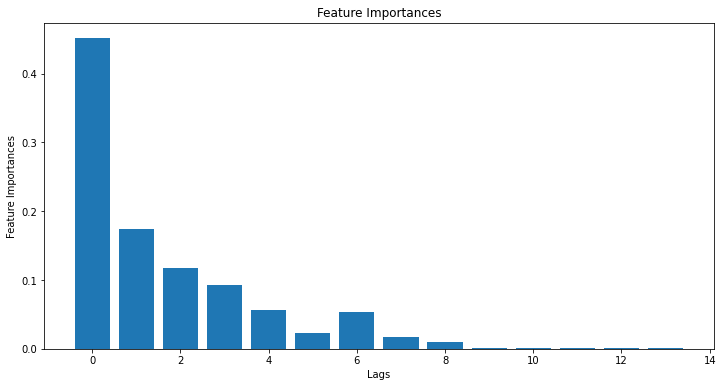

In [227]:
# Because there is no way to do feature selection, let's have a look at feature importance.
plt.figure(figsize=(12,6))
plt.bar(
    list(range(len(cv_model_rf.bestModel.stages[-1].featureImportances))), 
    cv_model_rf.bestModel.stages[-1].featureImportances
)
plt.ylabel('Feature Importances')
plt.xlabel('Lags')
plt.title('Feature Importances')

This graph echoes the results obtained earlier for the linear regression, only the first 6-8 lags are important in the forecast of the price of petrol.